In [2]:
import os
import pickle

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!pip install scipy==1.1.0

     |████████████████████████████████| 31.2MB 172kB/s 
ERROR: umap-learn 0.4.6 has requirement scipy>=1.3.1, but you'll have scipy 1.1.0 which is incompatible.
ERROR: tensorflow 2.3.0 has requirement scipy==1.4.1, but you'll have scipy 1.1.0 which is incompatible.
ERROR: plotnine 0.6.0 has requirement scipy>=1.2.0, but you'll have scipy 1.1.0 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1


In [5]:
import itertools, imageio, torch, random
import time
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
from torchvision import datasets
from scipy.misc import imresize
from torch.autograd import Variable
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from torchvision import transforms
  
import torch.nn as nn
import torch.nn.functional as F

In [6]:
args = {'name': 'sample_data', 
        'src_data': 'src_data_path', 
        'tgt_data': 'tgt_data_path', 
        'vgg_model': 'pre_trained_VGG19_model_path/vgg19.pth', 
        'in_ngc': 3, 
        'out_ngc': 3, 
        'in_ndc': 3, 
        'out_ndc': 1, 
        'batch_size': 8, 
        'ngf': 64, 
        'ndf': 32, 
        'nb': 8, 
        'input_size': 256, 
        'train_epoch': 40, 
        'pre_train_epoch': 10, 
        'lrD': 0.0002, 
        'lrG': 0.0002, 
        'con_lambda': 10, 
        'beta1': 0.5, 
        'beta2': 0.999, 
        'latest_generator_model': '', 
        'latest_discriminator_model': ''}

In [7]:
def data_load(path, subfolder, transform, batch_size, shuffle=False, drop_last=True):
    dset = datasets.ImageFolder(path, transform)
    ind = dset.class_to_idx[subfolder]

    n = 0
    for i in range(dset.__len__()):
        if ind != dset.imgs[n][1]:
            del dset.imgs[n]
            n -= 1

        n += 1

    return torch.utils.data.DataLoader(dset, batch_size=batch_size, shuffle=shuffle, drop_last=drop_last)

def print_network(net):
    num_params = 0
    for param in net.parameters():
        num_params += param.numel()
    print(net)
    print('Total number of parameters: %d' % num_params)

In [8]:
# data_loader
# input_size is 256x256
src_transform = transforms.Compose([
        transforms.Resize((args['input_size'], args['input_size'])),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])
tgt_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])

In [9]:
data_path = '/content/drive/MyDrive/archive/ds_data'

In [10]:
train_loader_src = data_load(os.path.join(data_path, 'src_data'), 'train', src_transform, args['batch_size'], shuffle=True, drop_last=True)
train_loader_tgt = data_load(os.path.join(data_path, 'tgt_data'), 'pair', tgt_transform, args['batch_size'], shuffle=True, drop_last=True)
test_loader_src = data_load(os.path.join(data_path, 'src_data'), 'test', src_transform, 1, shuffle=True, drop_last=True)

In [11]:
def initialize_weights(net):
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.ConvTranspose2d):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.Linear):
            m.weight.data.normal_(0, 0.02)
            m.bias.data.zero_()
        elif isinstance(m, nn.BatchNorm2d):
            m.weight.data.fill_(1)
            m.bias.data.zero_()
            
class resnet_block(nn.Module):
    def __init__(self, channel, kernel, stride, padding):
        super(resnet_block, self).__init__()
        self.channel = channel
        self.kernel = kernel
        self.strdie = stride
        self.padding = padding
        self.conv1 = nn.Conv2d(channel, channel, kernel, stride, padding)
        self.conv1_norm = nn.InstanceNorm2d(channel)
        self.conv2 = nn.Conv2d(channel, channel, kernel, stride, padding)
        self.conv2_norm = nn.InstanceNorm2d(channel)

        initialize_weights(self)

    def forward(self, input):
        x = F.relu(self.conv1_norm(self.conv1(input)), True)
        x = self.conv2_norm(self.conv2(x))

        return input + x #Elementwise Sum
 

class generator(nn.Module):
    # initializers
    def __init__(self, in_nc, out_nc, nf=32, nb=6):
        super(generator, self).__init__()
        self.input_nc = in_nc
        self.output_nc = out_nc
        self.nf = nf
        self.nb = nb
        self.down_convs = nn.Sequential(
            nn.Conv2d(in_nc, nf, 7, 1, 3), #k7n64s1
            nn.InstanceNorm2d(nf),
            nn.ReLU(True),
            nn.Conv2d(nf, nf * 2, 3, 2, 1), #k3n128s2
            nn.Conv2d(nf * 2, nf * 2, 3, 1, 1), #k3n128s1
            nn.InstanceNorm2d(nf * 2),
            nn.ReLU(True),
            nn.Conv2d(nf * 2, nf * 4, 3, 2, 1), #k3n256s1
            nn.Conv2d(nf * 4, nf * 4, 3, 1, 1), #k3n256s1
            nn.InstanceNorm2d(nf * 4),
            nn.ReLU(True),
        )

        self.resnet_blocks = []
        for i in range(nb):
            self.resnet_blocks.append(resnet_block(nf * 4, 3, 1, 1))

        self.resnet_blocks = nn.Sequential(*self.resnet_blocks)

        self.up_convs = nn.Sequential(
            nn.ConvTranspose2d(nf * 4, nf * 2, 3, 2, 1, 1), #k3n128s1/2
            nn.Conv2d(nf * 2, nf * 2, 3, 1, 1), #k3n128s1
            nn.InstanceNorm2d(nf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(nf * 2, nf, 3, 2, 1, 1), #k3n64s1/2
            nn.Conv2d(nf, nf, 3, 1, 1), #k3n64s1
            nn.InstanceNorm2d(nf),
            nn.ReLU(True),
            nn.Conv2d(nf, out_nc, 7, 1, 3), #k7n3s1
            nn.Tanh(),
        )

        initialize_weights(self)

    # forward method
    def forward(self, input):
        x = self.down_convs(input)
        x = self.resnet_blocks(x)
        output = self.up_convs(x)

        return output


class discriminator(nn.Module):
    # initializers
    def __init__(self, in_nc, out_nc, nf=32):
        super(discriminator, self).__init__()
        self.input_nc = in_nc
        self.output_nc = out_nc
        self.nf = nf
        self.convs = nn.Sequential(
            nn.Conv2d(in_nc, nf, 3, 1, 1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf, nf * 2, 3, 2, 1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf * 2, nf * 4, 3, 1, 1),
            nn.InstanceNorm2d(nf * 4),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf * 4, nf * 4, 3, 2, 1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf * 4, nf * 8, 3, 1, 1),
            nn.InstanceNorm2d(nf * 8),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf * 8, nf * 8, 3, 1, 1),
            nn.InstanceNorm2d(nf * 8),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(nf * 8, out_nc, 3, 1, 1),
            nn.Sigmoid(),
        )

        initialize_weights(self)

    # forward method
    def forward(self, input):
        # input = torch.cat((input1, input2), 1)
        output = self.convs(input)

        return output


class VGG19(nn.Module):
    def __init__(self, init_weights=None, feature_mode=False, batch_norm=False, num_classes=1000):
        super(VGG19, self).__init__()
        self.cfg = [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 256, 'M', 512, 512, 512, 512, 'M', 512, 512, 512, 512, 'M']
        self.init_weights = init_weights
        self.feature_mode = feature_mode
        self.batch_norm = batch_norm
        self.num_clases = num_classes
        self.features = self.make_layers(self.cfg, batch_norm)
        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, num_classes),
        )
        if not init_weights == None:
            self.load_state_dict(torch.load(init_weights))

    def make_layers(self, cfg, batch_norm=False):
        layers = []
        in_channels = 3
        for v in cfg:
            if v == 'M':
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
            else:
                conv2d = nn.Conv2d(in_channels, v, kernel_size=3, padding=1)
                if batch_norm:
                    layers += [conv2d, nn.BatchNorm2d(v), nn.ReLU(inplace=True)]
                else:
                    layers += [conv2d, nn.ReLU(inplace=True)]
                in_channels = v
        return nn.Sequential(*layers)

    def forward(self, x):
        if self.feature_mode:
            module_list = list(self.features.modules())
            for l in module_list[1:27]:                 # conv4_4
                x = l(x)
        if not self.feature_mode:
            x = x.view(x.size(0), -1)
            x = self.classifier(x)

        return x

In [12]:
Gen = generator(args['in_ngc'], args['out_ngc'], args['ngf'], args['nb'])
Dis = discriminator(args['in_ndc'], args['out_ndc'], args['ndf'])

In [12]:
# vgg_model_path = os.path.join(data_path,'vgg19-dcbb9e9d.pth')
# VGG = VGG19(init_weights=vgg_model_path, feature_mode=True)

In [13]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
Gen.to(device)
# Dis.to(device)
# VGG.to(device)
Gen.eval()
# Dis.eval()
# VGG.eval()
# print('---------- Networks initialized -------------')
print_network(Gen)
# print_network(Dis)
# print_network(VGG)
# print('-----------------------------------------------')

generator(
  (down_convs): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): ReLU(inplace=True)
  )
  (resnet_blocks): Sequential(
    (0): resnet_block(
      (conv1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv1_norm): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affin

In [14]:
# # optimizers
# BCE_loss = nn.BCELoss().to(device)
# L1_loss = nn.L1Loss().to(device)
# G_optimizer = optim.Adam(Gen.parameters(), lr=args['lrG'], betas=(args['beta1'], args['beta2']))
# D_optimizer = optim.Adam(Dis.parameters(), lr=args['lrD'], betas=(args['beta1'], args['beta2']))
# G_scheduler = optim.lr_scheduler.MultiStepLR(optimizer=G_optimizer, milestones=[args['train_epoch'] // 2, 
#                                                                                 args['train_epoch'] // 4 * 3], 
#                                                                                 gamma=0.1)
# D_scheduler = optim.lr_scheduler.MultiStepLR(optimizer=D_optimizer, milestones=[args['train_epoch'] // 2, 
#                                                                                 args['train_epoch'] // 4 * 3], gamma=0.1)


In [15]:
# paths for saving
if not os.path.isdir(os.path.join(args['name'] + '_results', 'Reconstruction')):
    os.makedirs(os.path.join(args['name'] + '_results', 'Reconstruction'))

if not os.path.isdir(os.path.join(args['name'] + '_results', 'Transfer')):
    os.makedirs(os.path.join(args['name'] + '_results', 'Transfer'))

# Inference

In [16]:
results_path = 'epochs40'
drive_models = os.path.join(data_path, results_path)

In [17]:
import matplotlib.pyplot as plt
%matplotlib inline

/content/drive/MyDrive/archive/ds_data/epochs40/generator_0.pkl


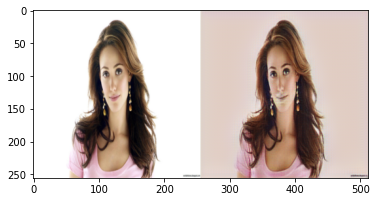

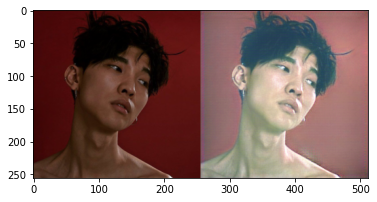

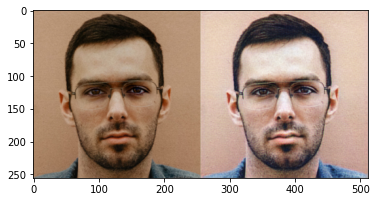

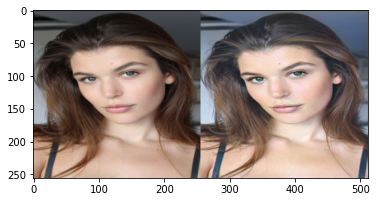

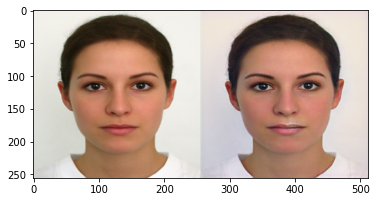

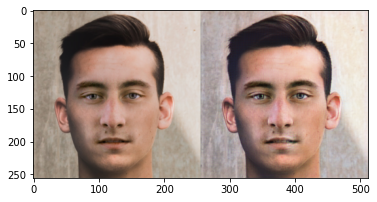

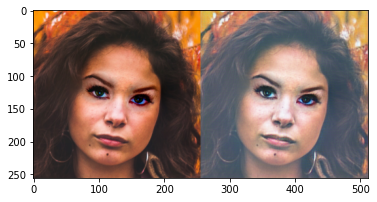

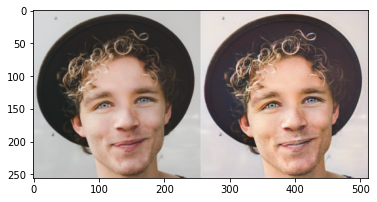

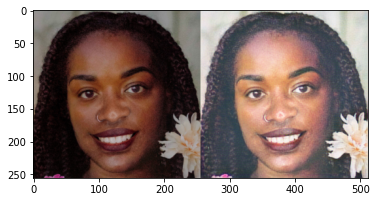

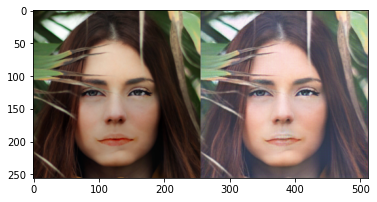

/content/drive/MyDrive/archive/ds_data/epochs40/generator_1.pkl


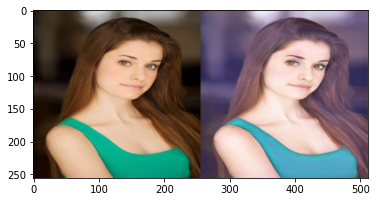

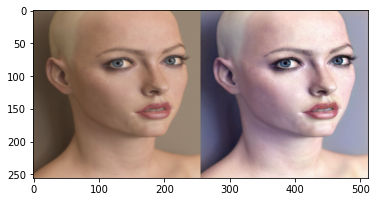

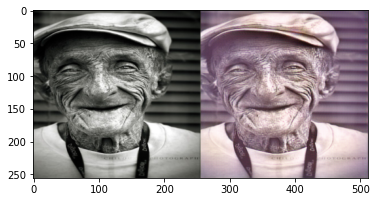

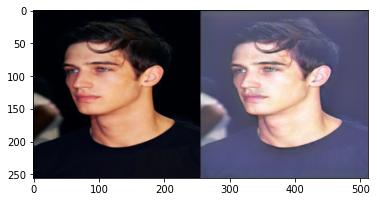

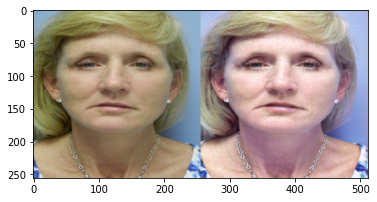

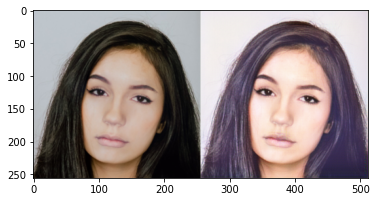

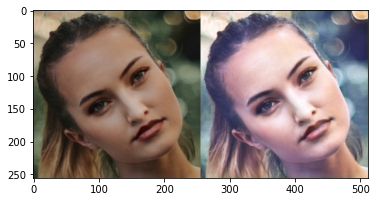

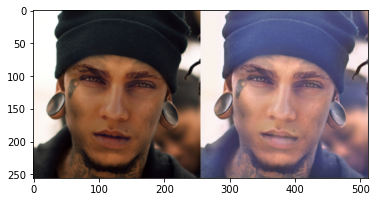

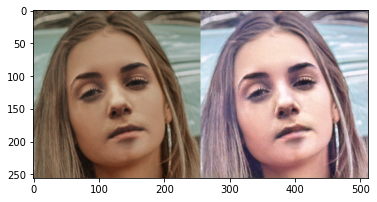

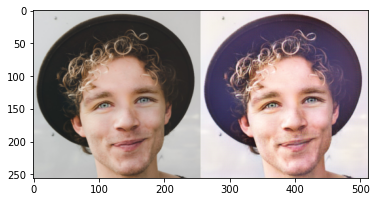

/content/drive/MyDrive/archive/ds_data/epochs40/generator_2.pkl


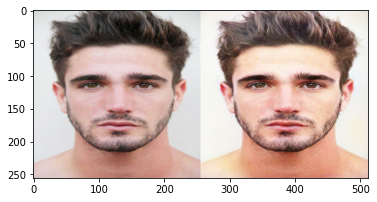

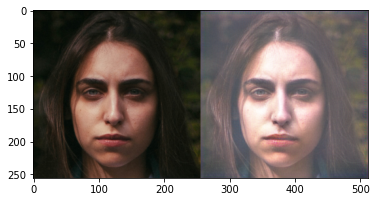

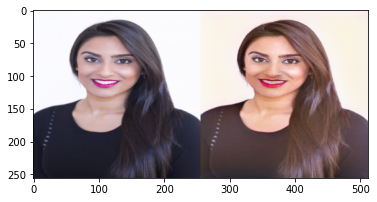

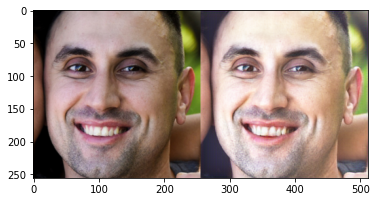

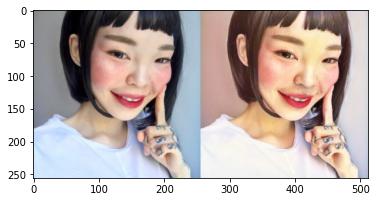

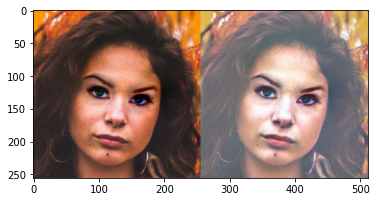

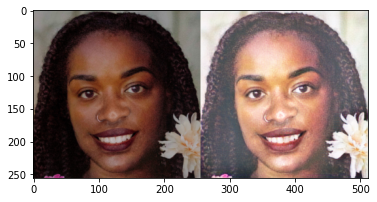

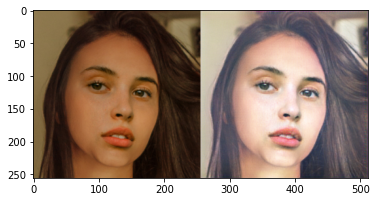

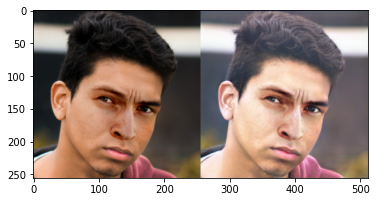

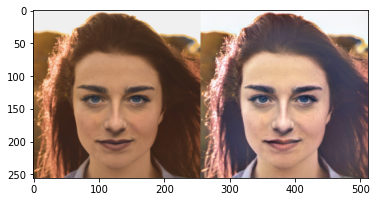

/content/drive/MyDrive/archive/ds_data/epochs40/generator_3.pkl


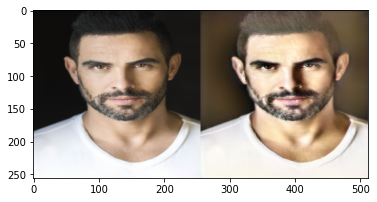

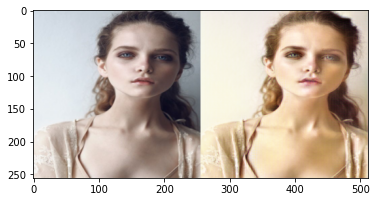

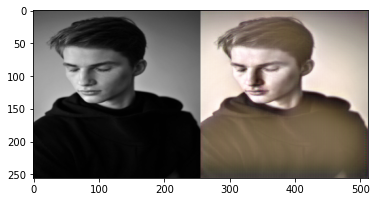

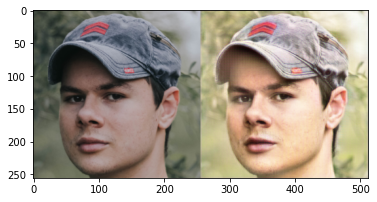

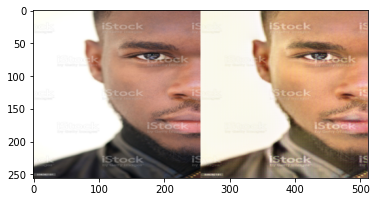

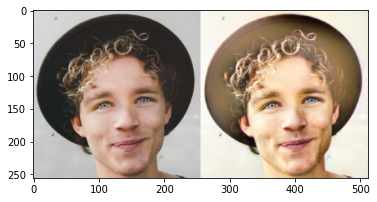

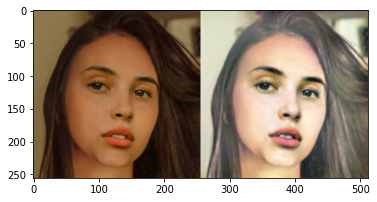

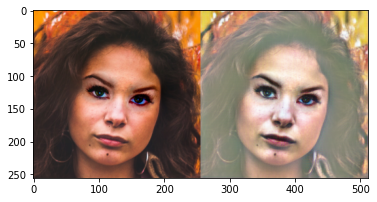

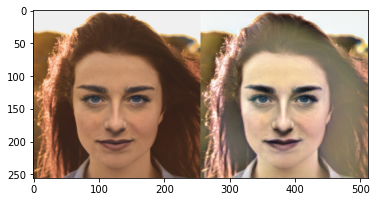

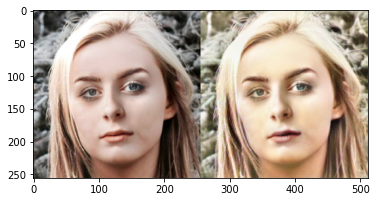

/content/drive/MyDrive/archive/ds_data/epochs40/generator_4.pkl


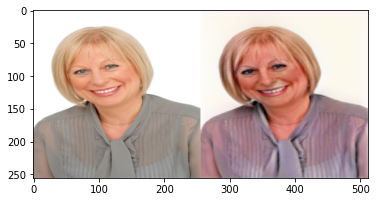

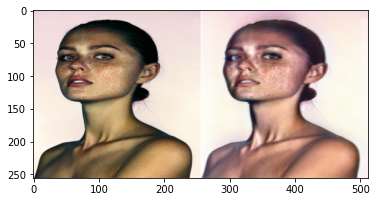

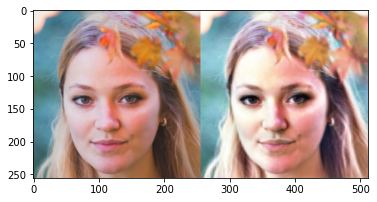

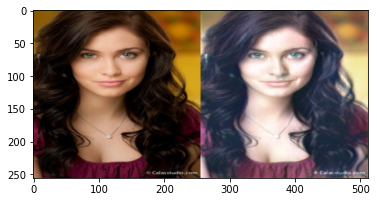

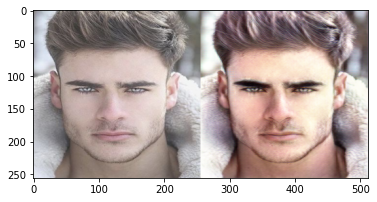

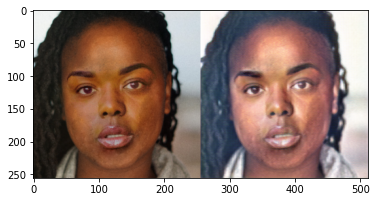

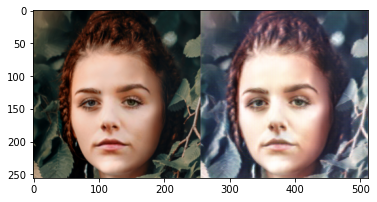

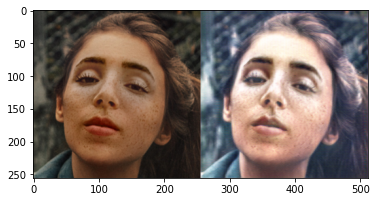

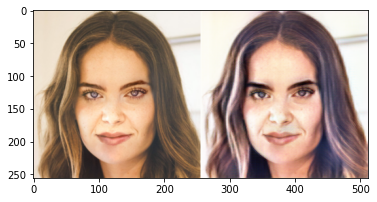

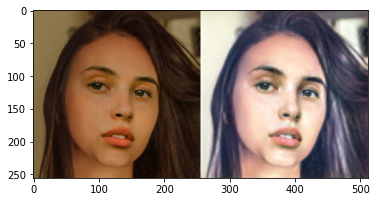

/content/drive/MyDrive/archive/ds_data/epochs40/generator_5.pkl


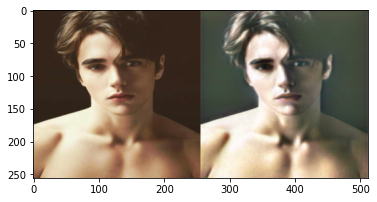

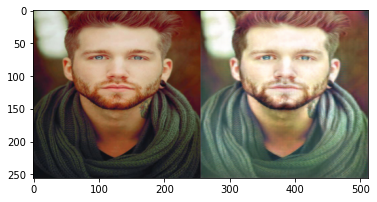

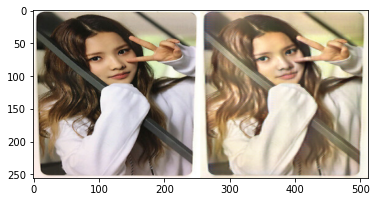

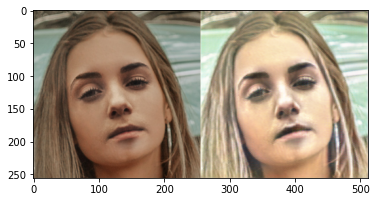

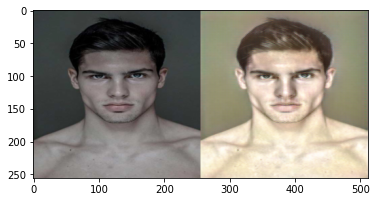

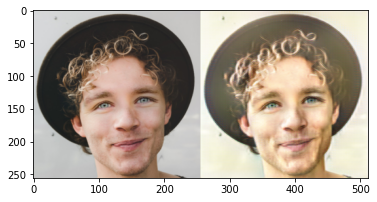

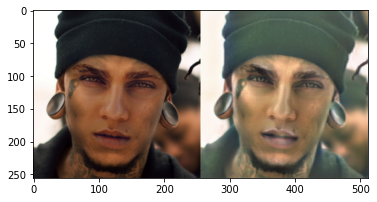

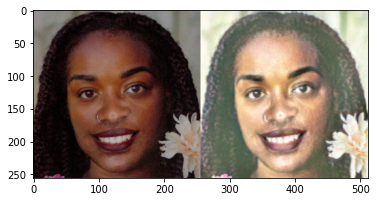

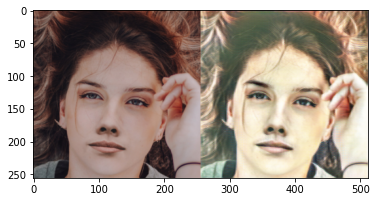

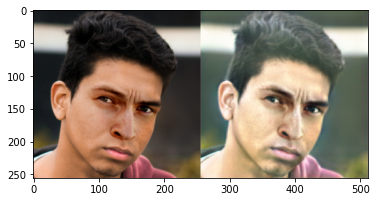

/content/drive/MyDrive/archive/ds_data/epochs40/generator_6.pkl


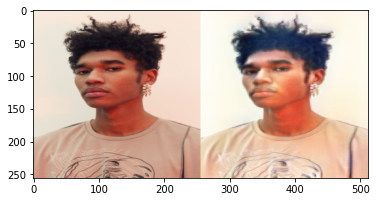

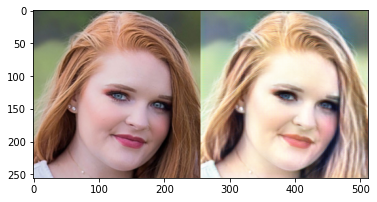

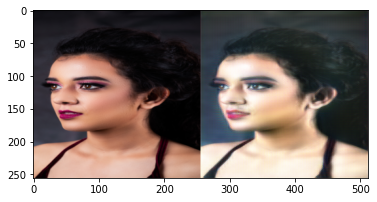

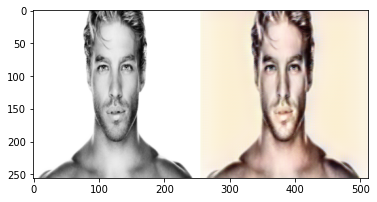

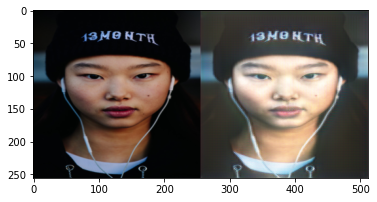

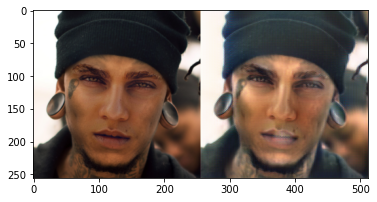

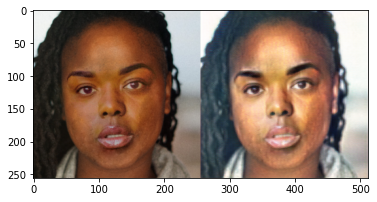

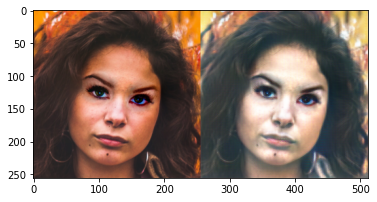

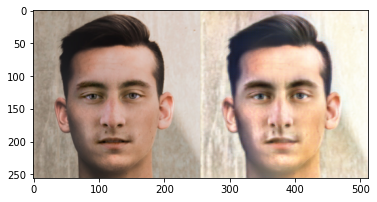

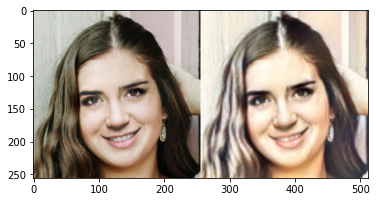

/content/drive/MyDrive/archive/ds_data/epochs40/generator_7.pkl


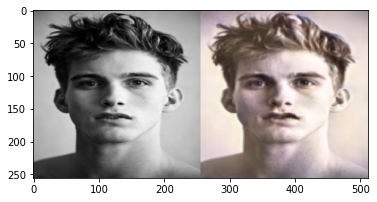

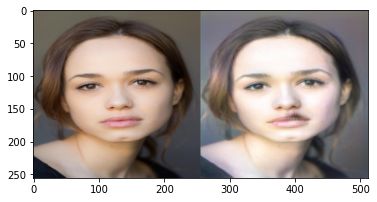

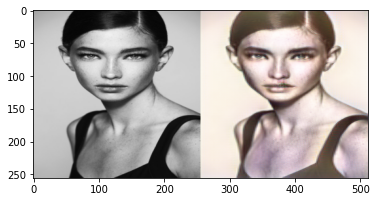

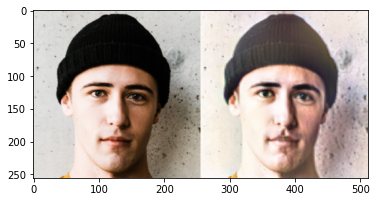

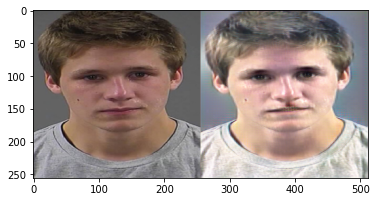

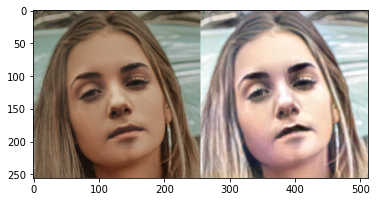

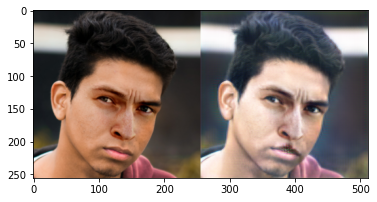

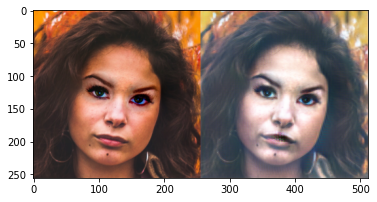

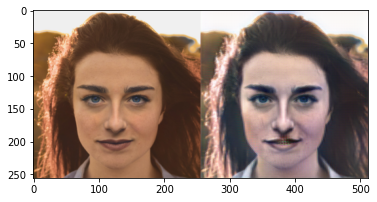

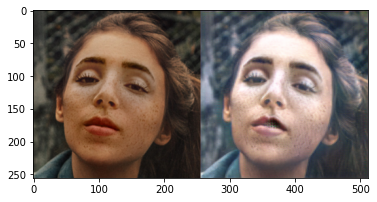

/content/drive/MyDrive/archive/ds_data/epochs40/generator_8.pkl


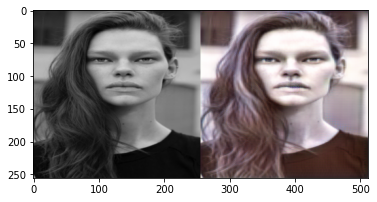

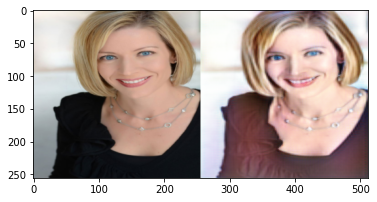

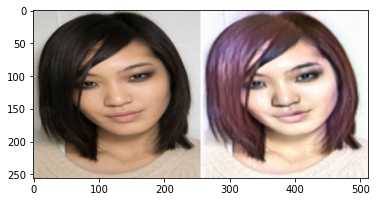

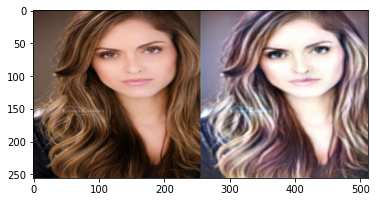

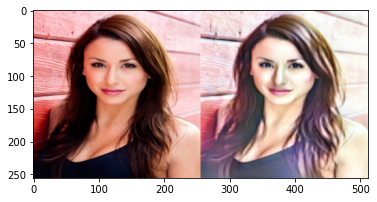

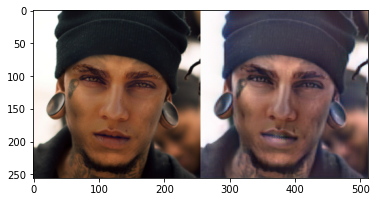

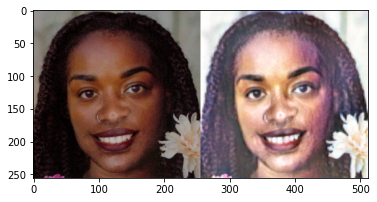

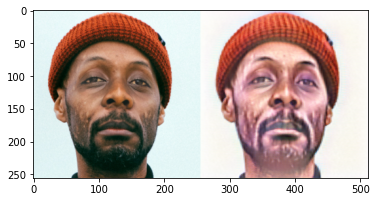

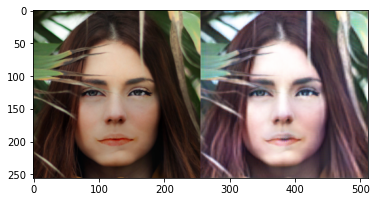

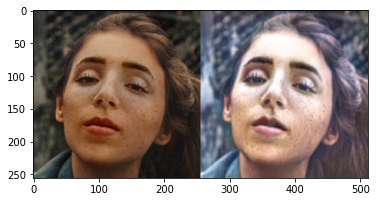

/content/drive/MyDrive/archive/ds_data/epochs40/generator_9.pkl


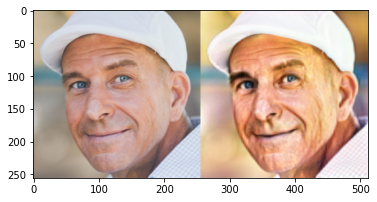

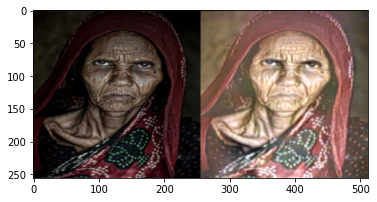

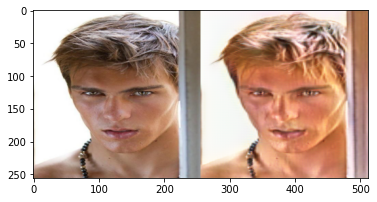

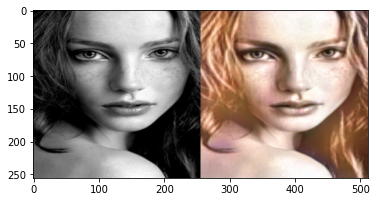

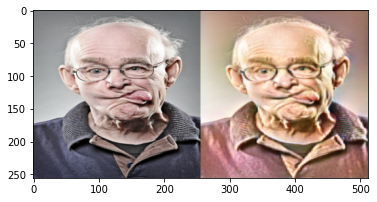

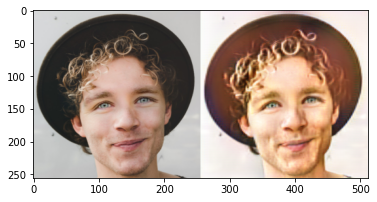

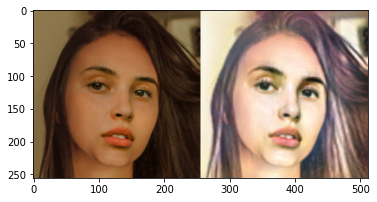

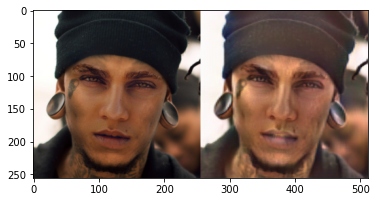

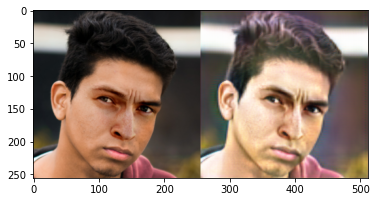

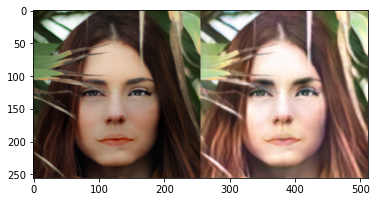

/content/drive/MyDrive/archive/ds_data/epochs40/generator_10.pkl


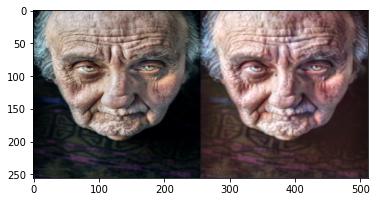

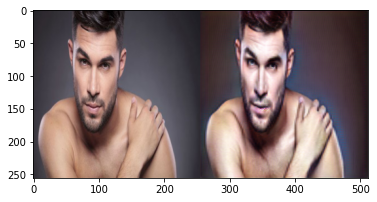

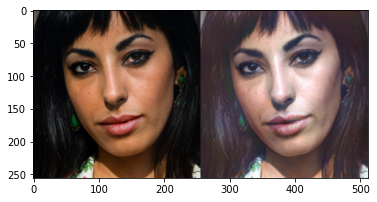

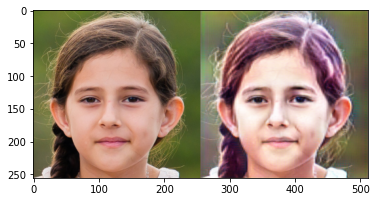

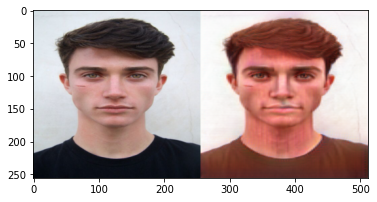

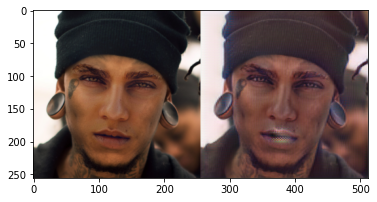

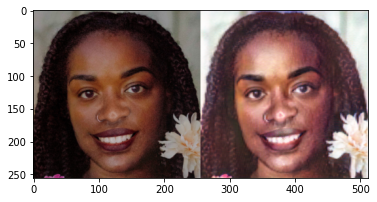

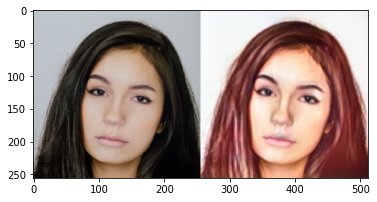

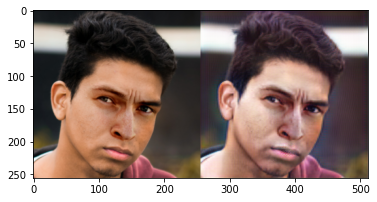

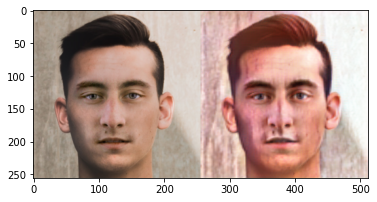

/content/drive/MyDrive/archive/ds_data/epochs40/generator_11.pkl


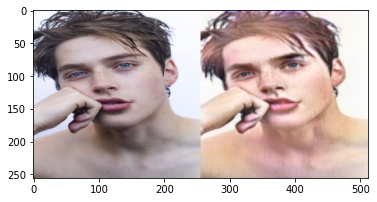

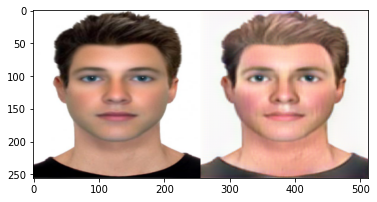

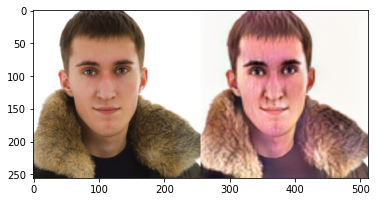

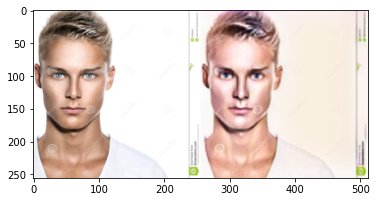

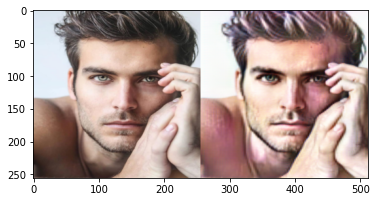

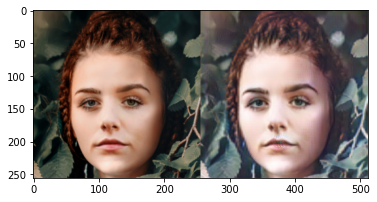

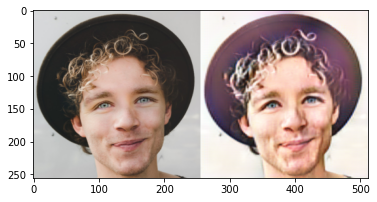

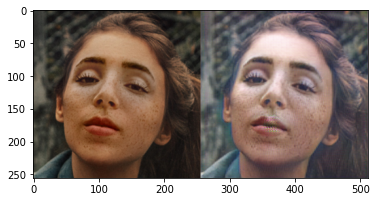

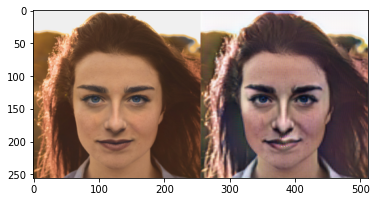

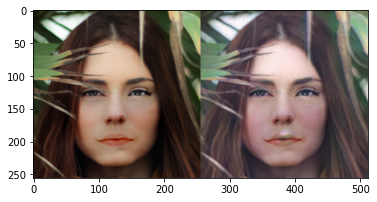

/content/drive/MyDrive/archive/ds_data/epochs40/generator_12.pkl


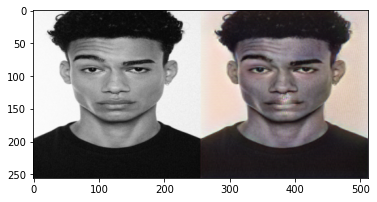

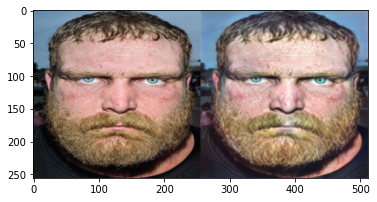

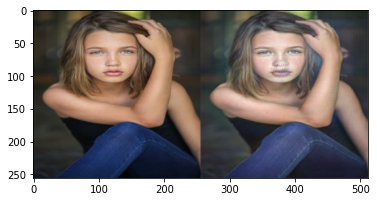

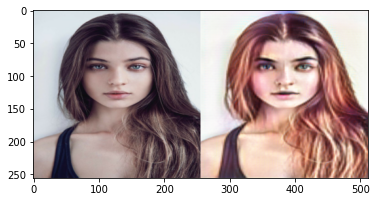

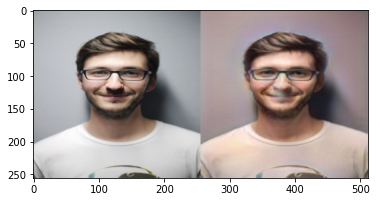

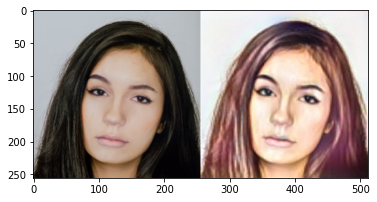

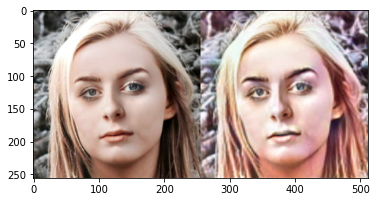

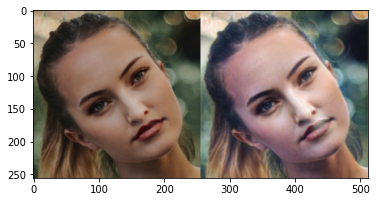

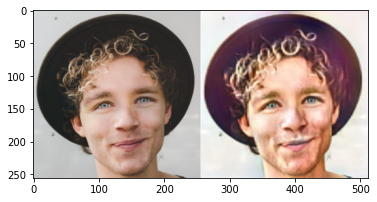

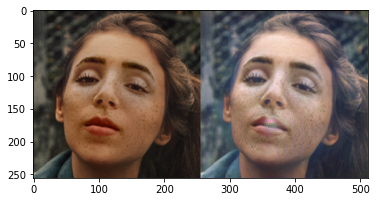

/content/drive/MyDrive/archive/ds_data/epochs40/generator_13.pkl


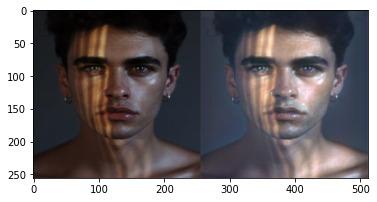

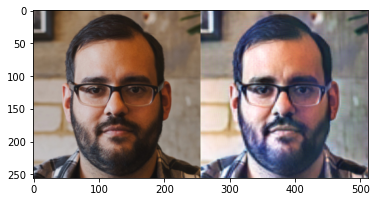

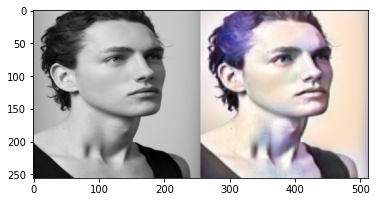

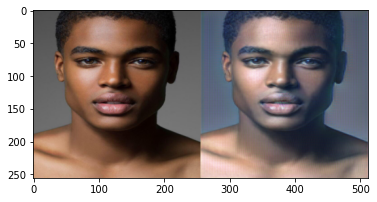

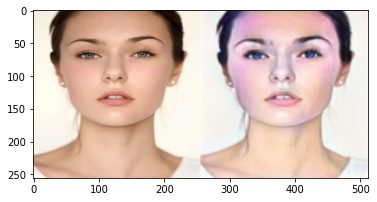

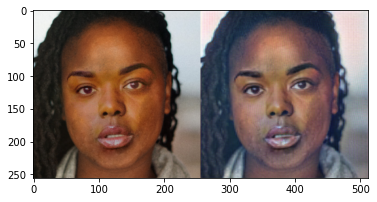

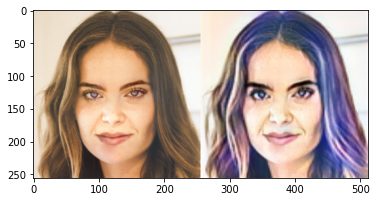

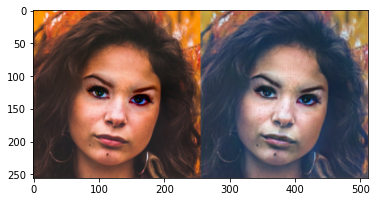

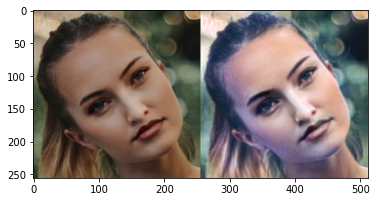

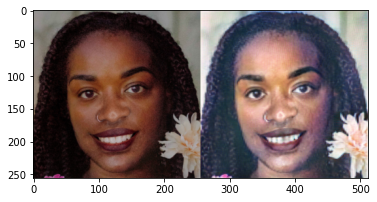

/content/drive/MyDrive/archive/ds_data/epochs40/generator_14.pkl


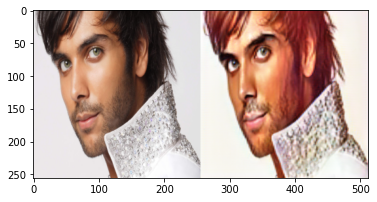

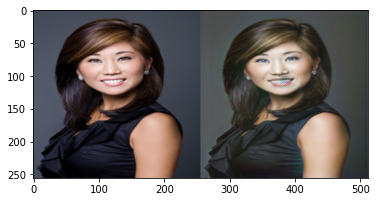

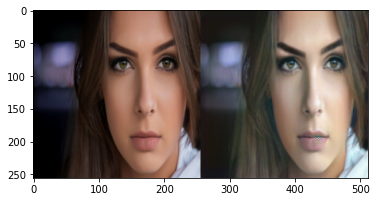

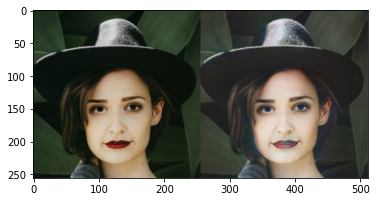

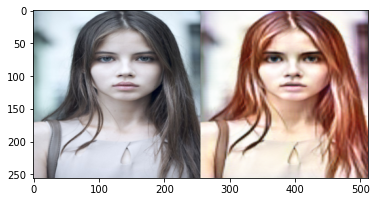

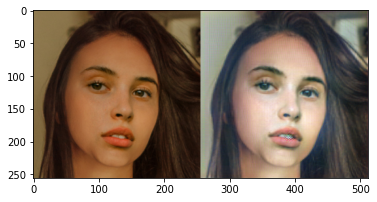

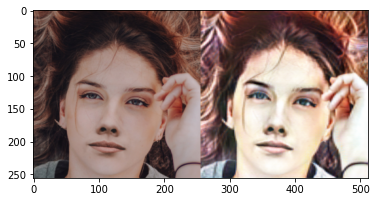

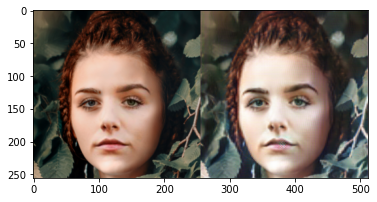

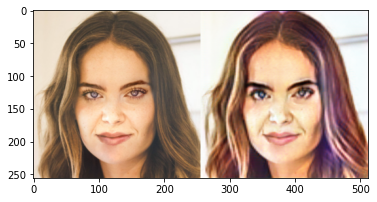

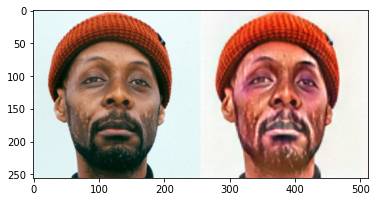

/content/drive/MyDrive/archive/ds_data/epochs40/generator_15.pkl


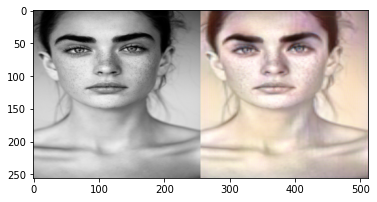

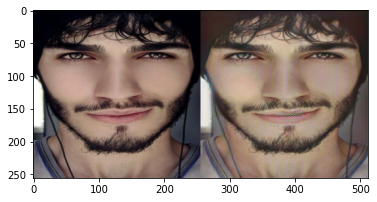

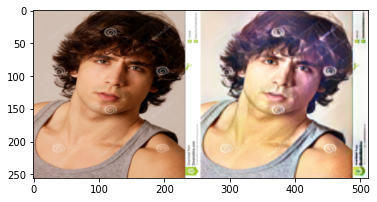

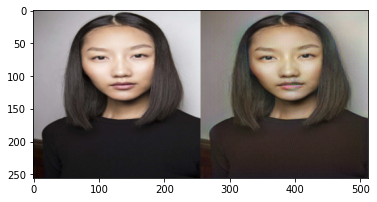

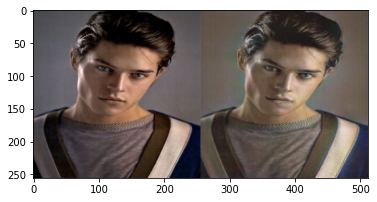

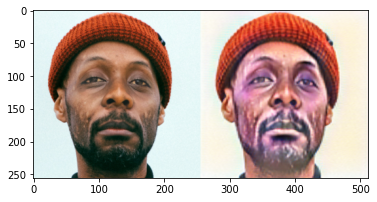

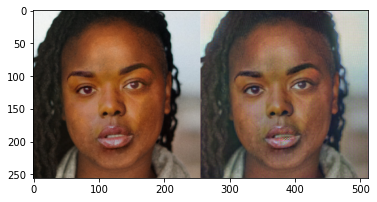

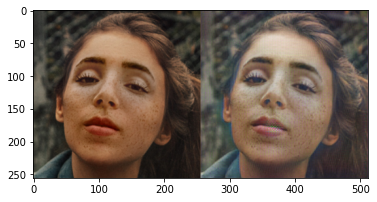

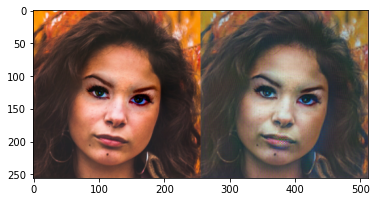

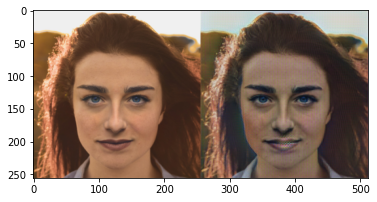

/content/drive/MyDrive/archive/ds_data/epochs40/generator_16.pkl


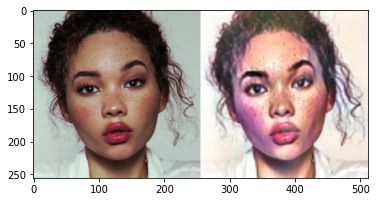

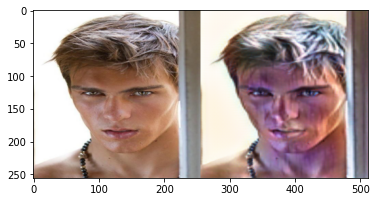

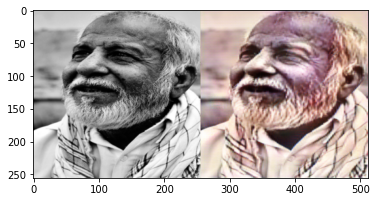

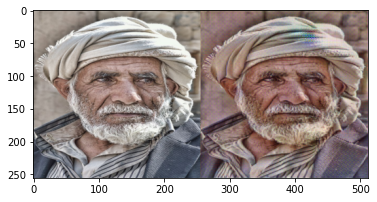

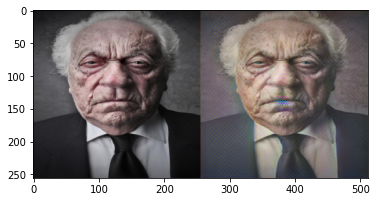

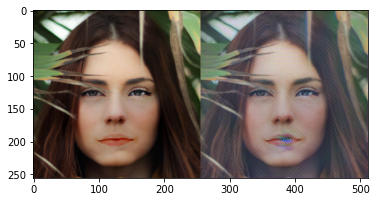

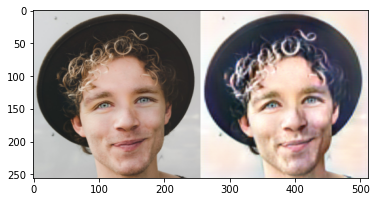

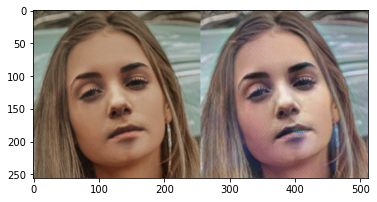

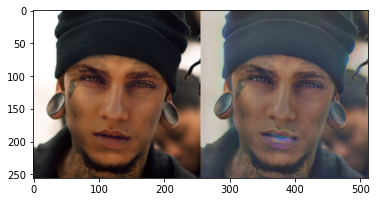

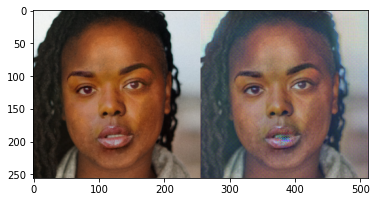

/content/drive/MyDrive/archive/ds_data/epochs40/generator_17.pkl


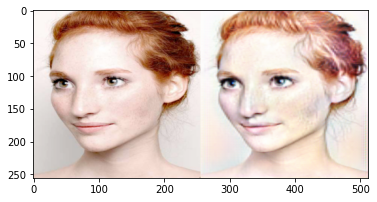

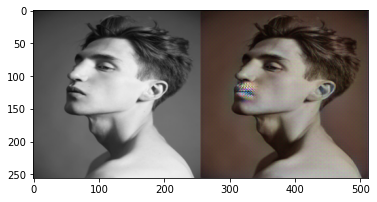

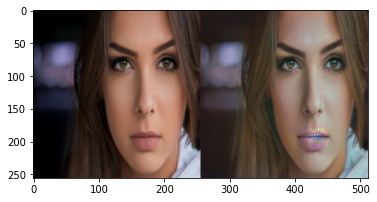

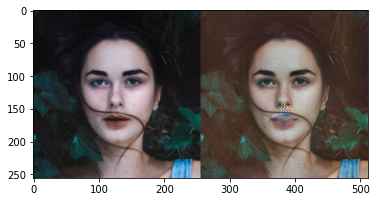

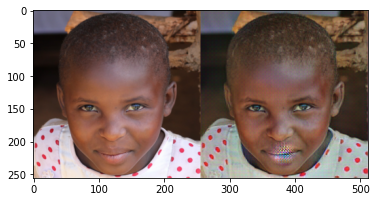

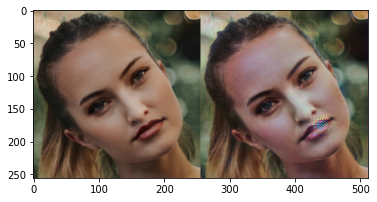

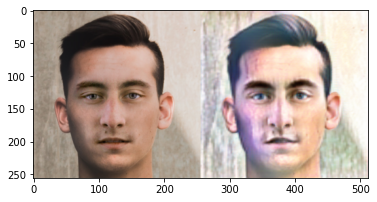

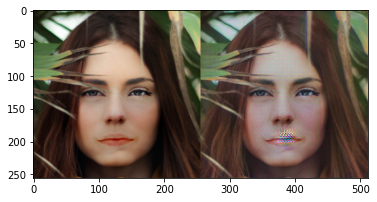

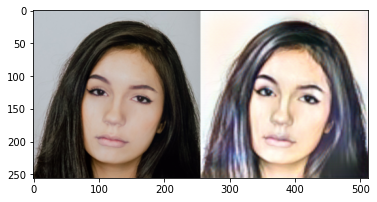

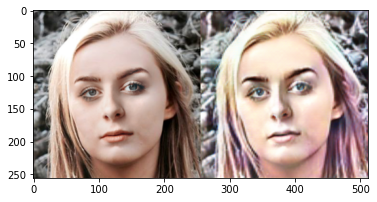

/content/drive/MyDrive/archive/ds_data/epochs40/generator_18.pkl


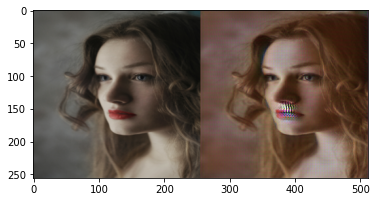

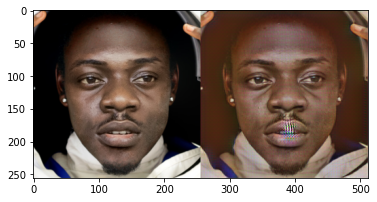

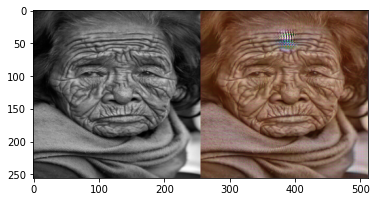

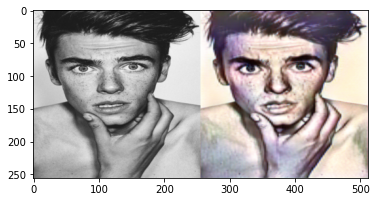

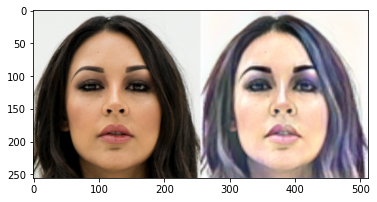

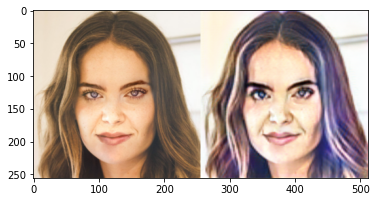

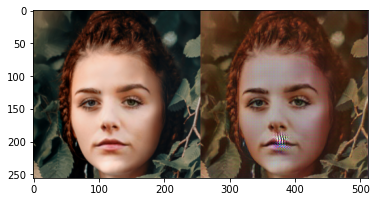

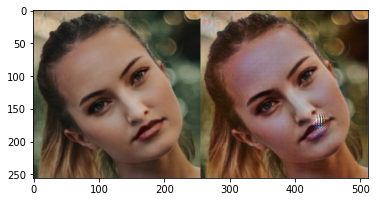

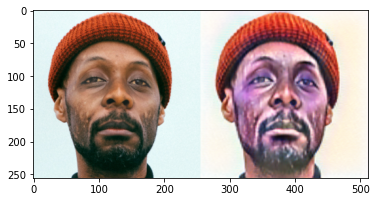

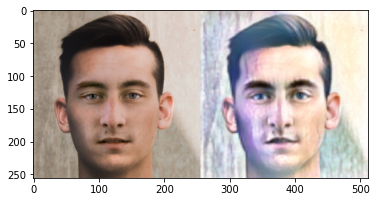

/content/drive/MyDrive/archive/ds_data/epochs40/generator_19.pkl


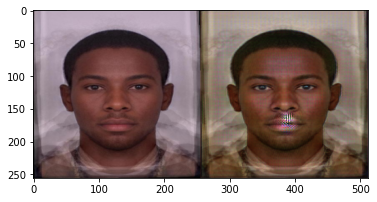

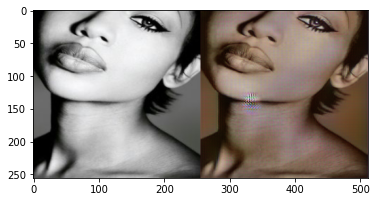

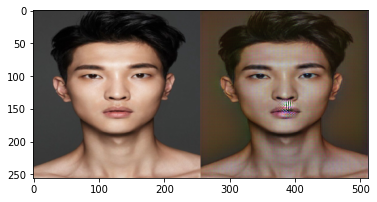

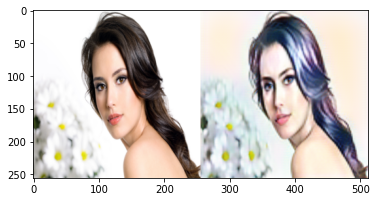

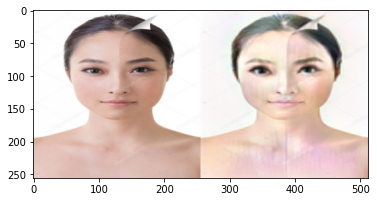

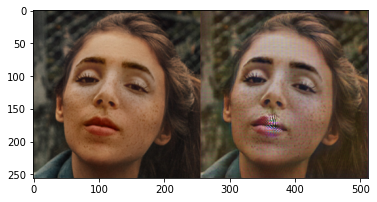

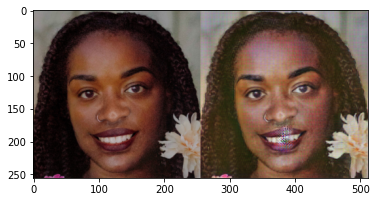

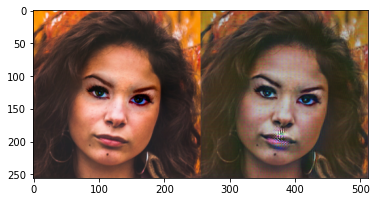

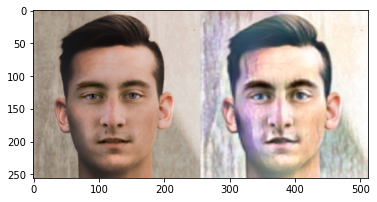

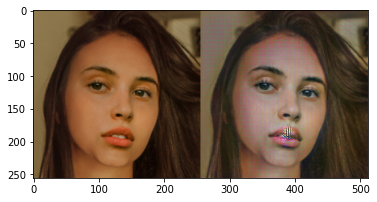

/content/drive/MyDrive/archive/ds_data/epochs40/generator_20.pkl


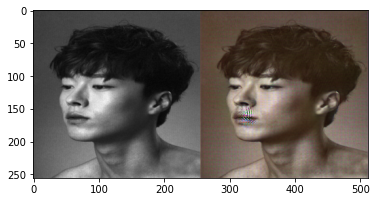

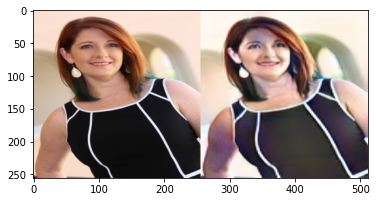

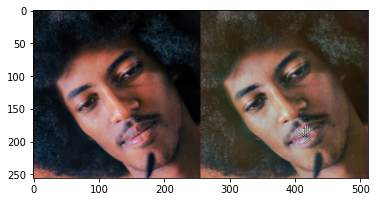

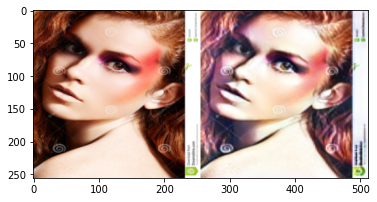

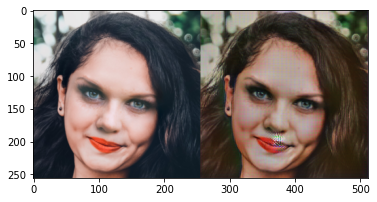

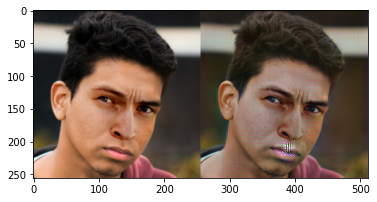

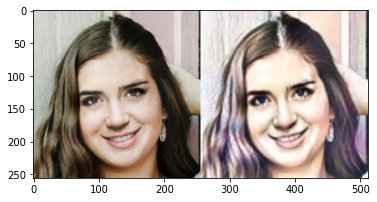

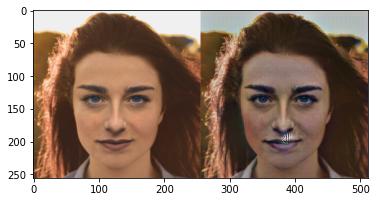

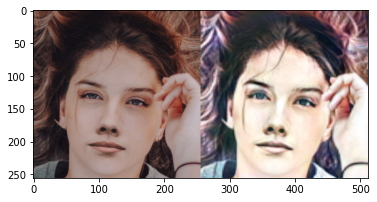

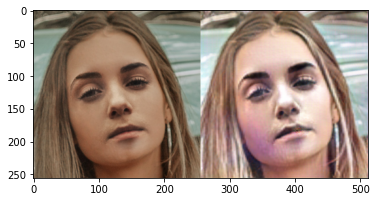

/content/drive/MyDrive/archive/ds_data/epochs40/generator_21.pkl


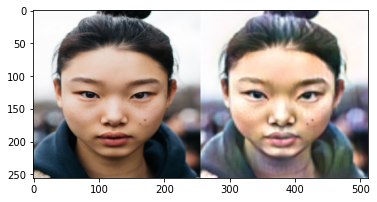

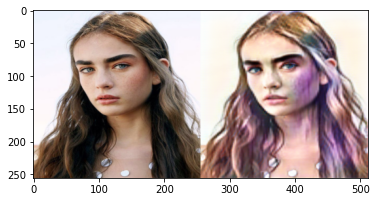

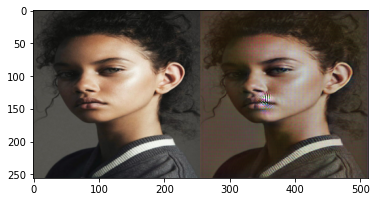

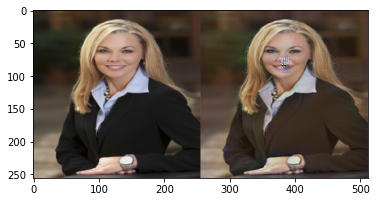

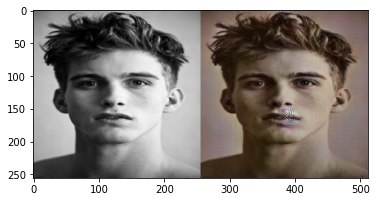

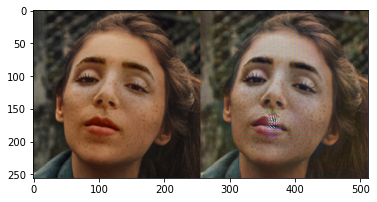

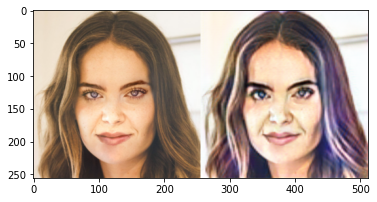

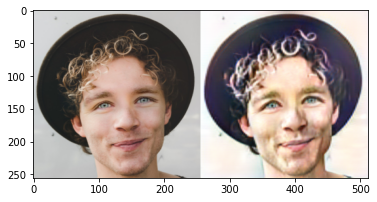

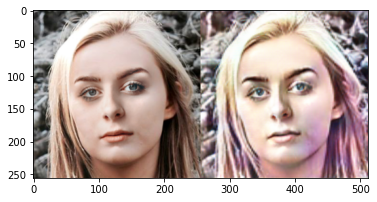

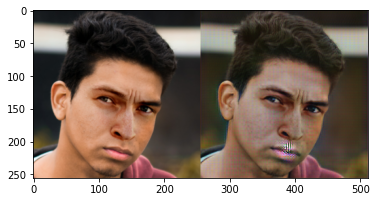

/content/drive/MyDrive/archive/ds_data/epochs40/generator_22.pkl


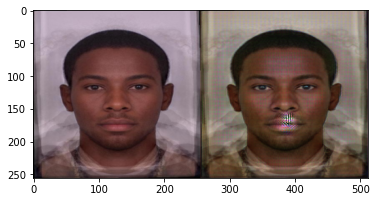

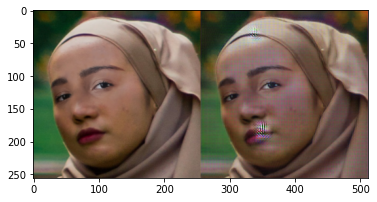

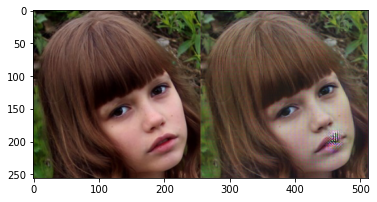

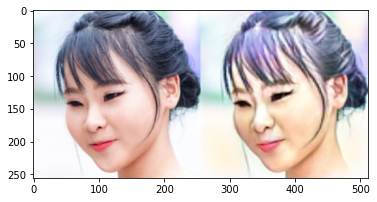

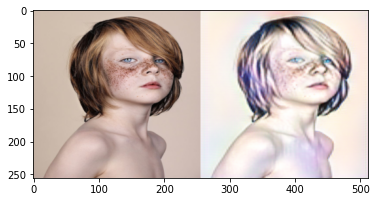

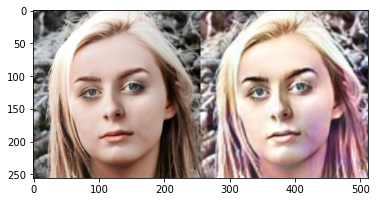

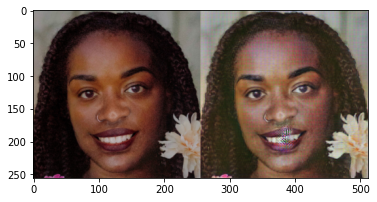

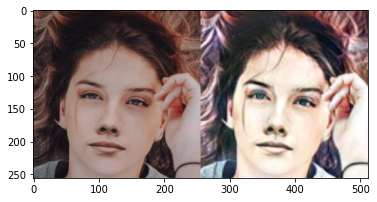

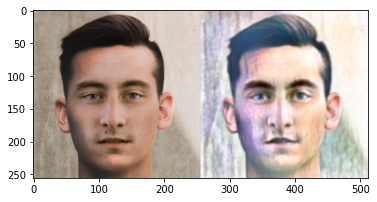

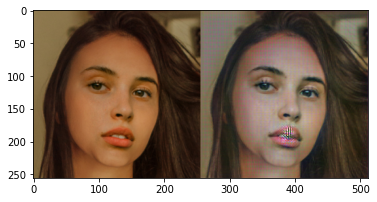

/content/drive/MyDrive/archive/ds_data/epochs40/generator_23.pkl


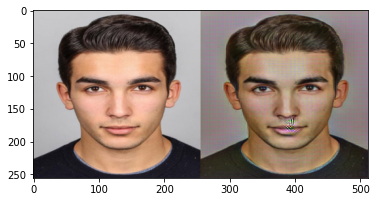

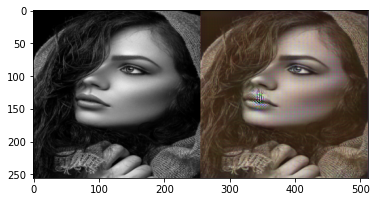

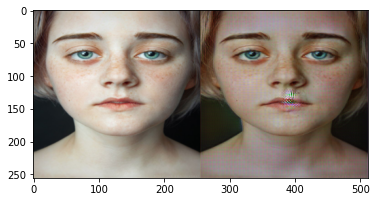

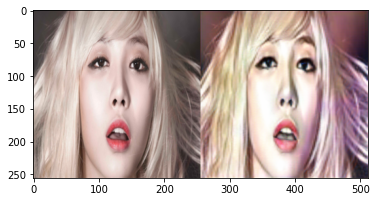

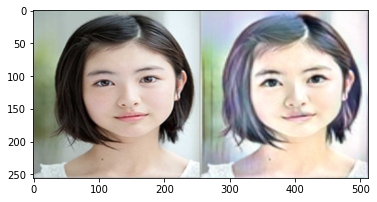

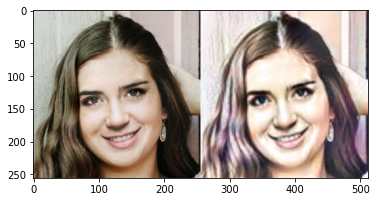

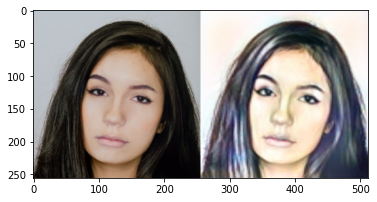

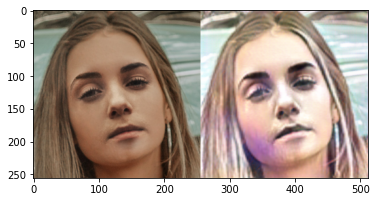

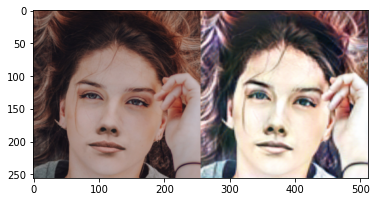

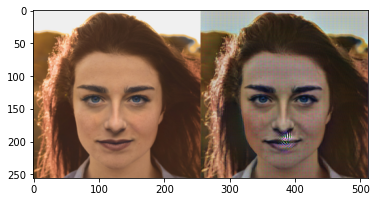

/content/drive/MyDrive/archive/ds_data/epochs40/generator_24.pkl


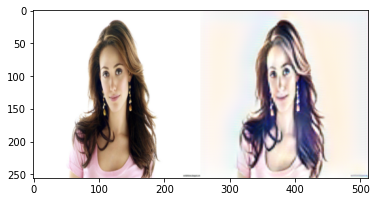

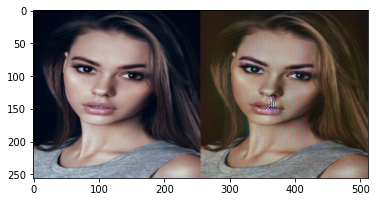

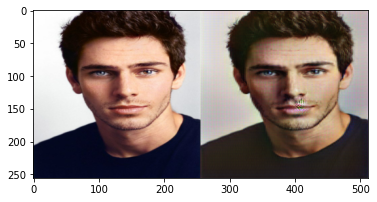

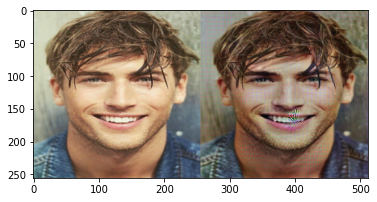

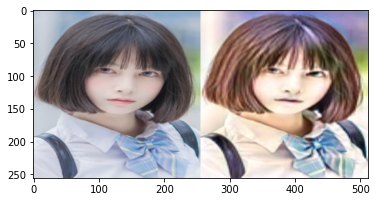

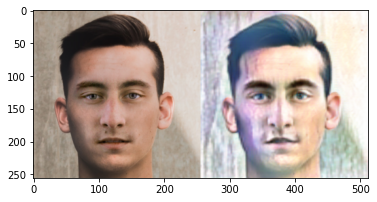

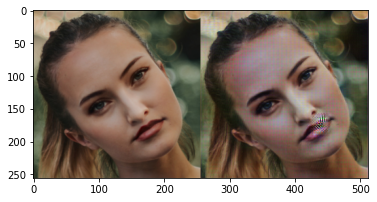

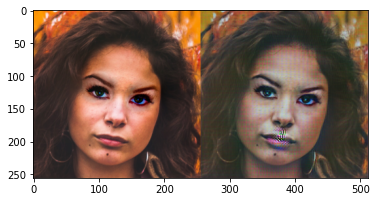

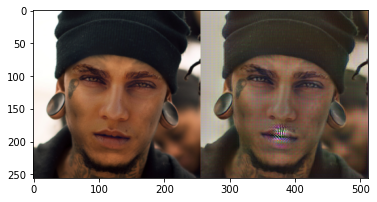

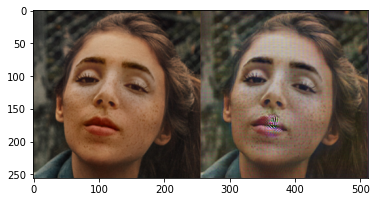

/content/drive/MyDrive/archive/ds_data/epochs40/generator_25.pkl


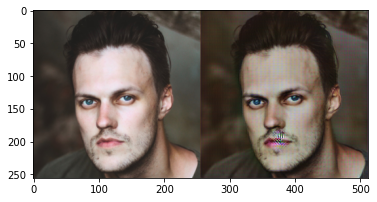

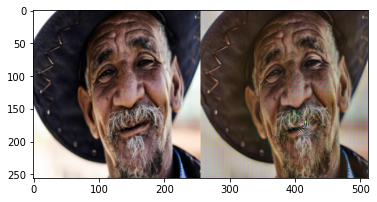

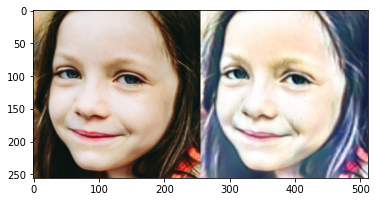

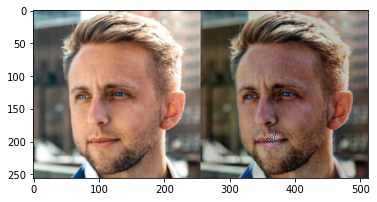

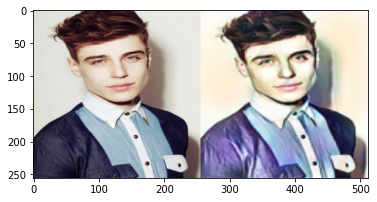

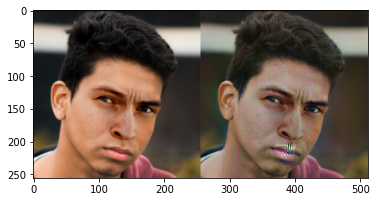

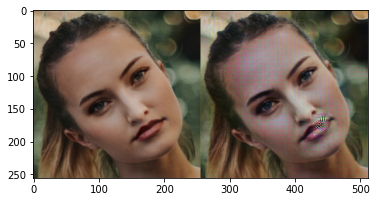

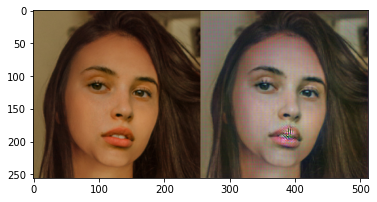

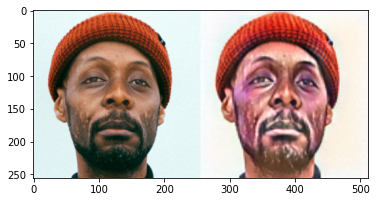

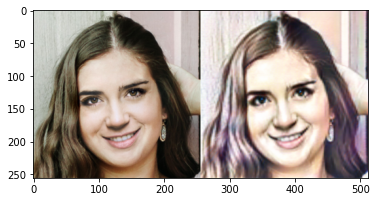

/content/drive/MyDrive/archive/ds_data/epochs40/generator_26.pkl


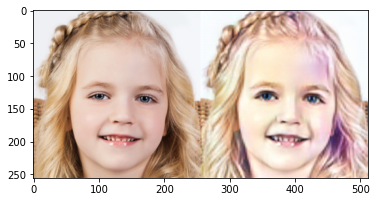

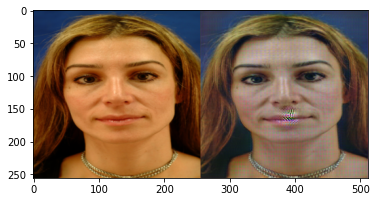

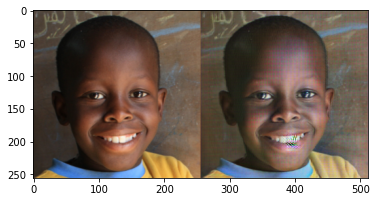

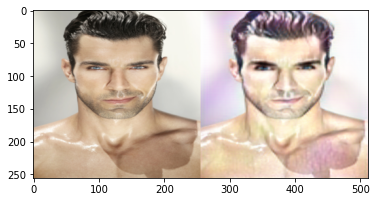

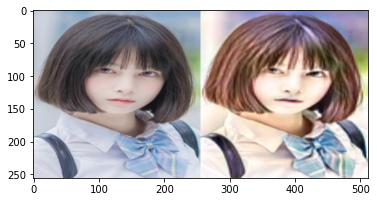

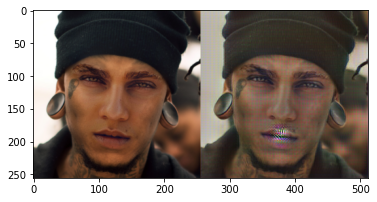

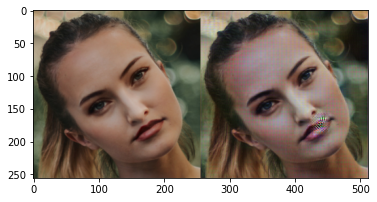

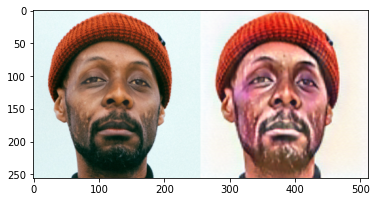

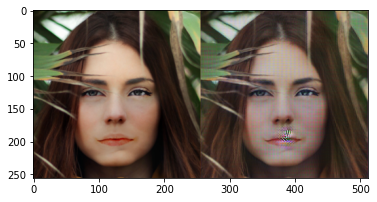

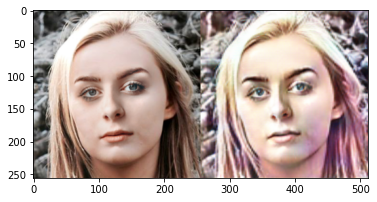

/content/drive/MyDrive/archive/ds_data/epochs40/generator_27.pkl


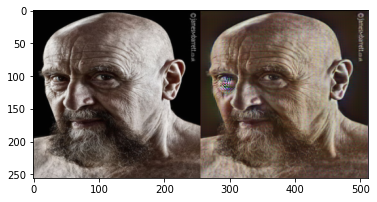

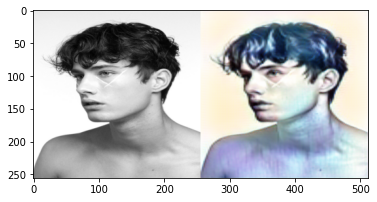

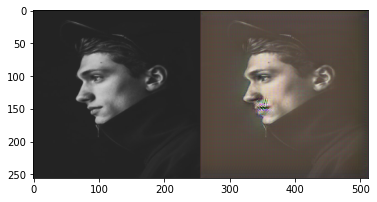

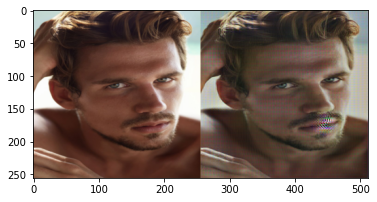

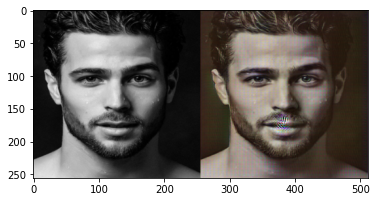

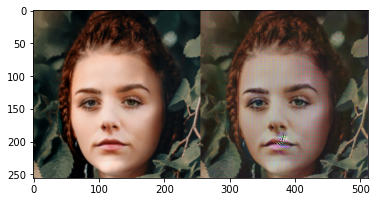

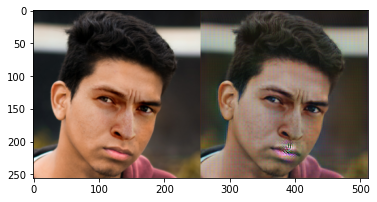

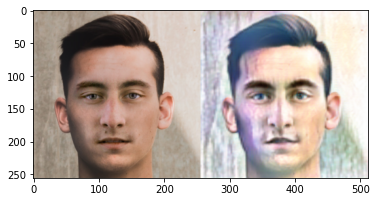

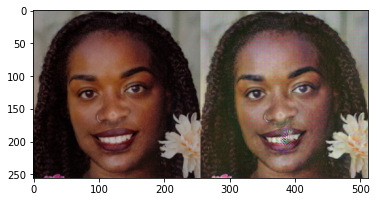

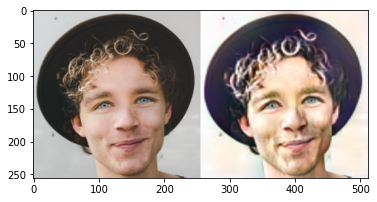

/content/drive/MyDrive/archive/ds_data/epochs40/generator_28.pkl


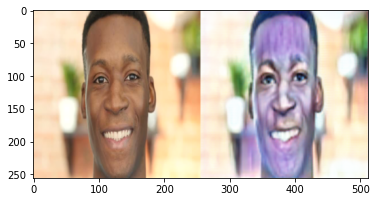

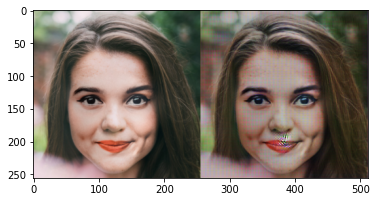

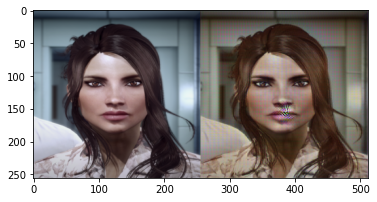

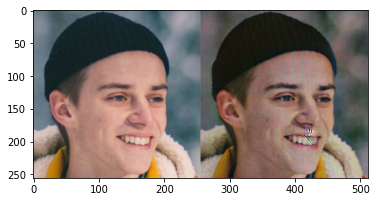

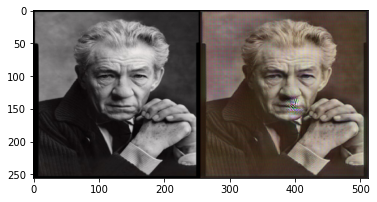

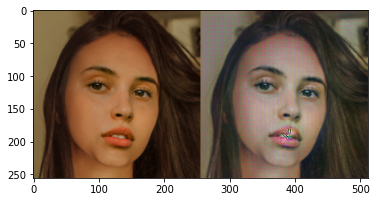

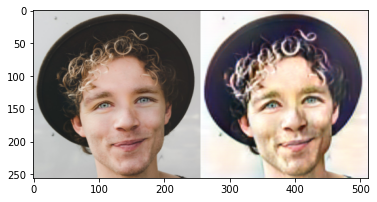

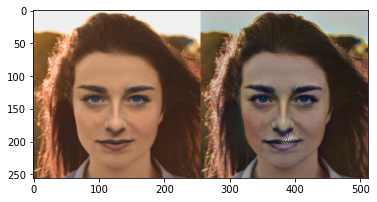

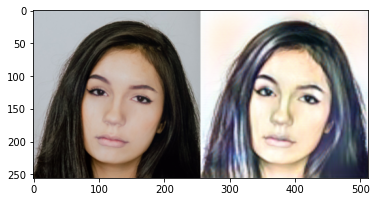

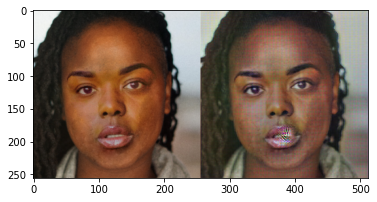

/content/drive/MyDrive/archive/ds_data/epochs40/generator_29.pkl


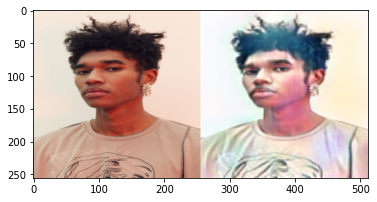

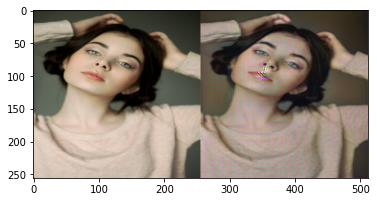

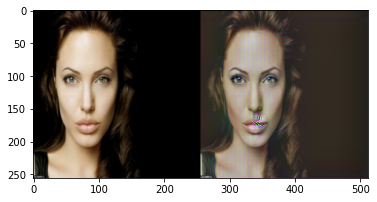

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


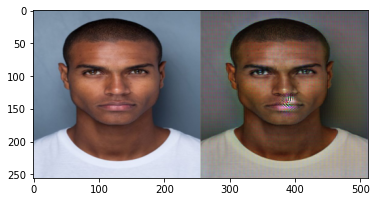

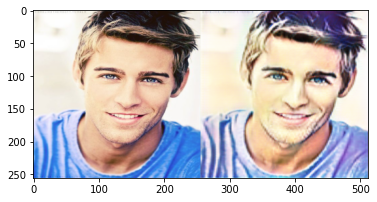

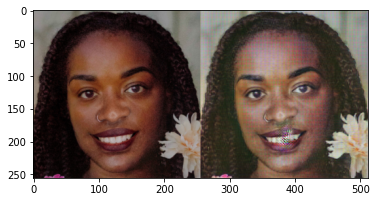

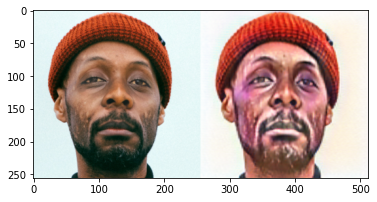

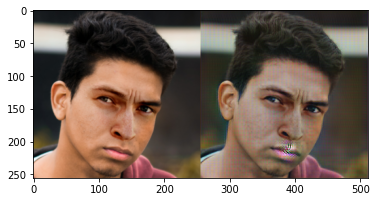

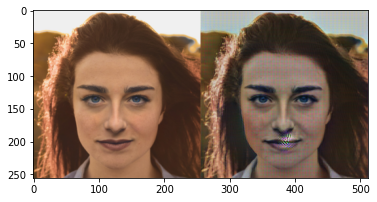

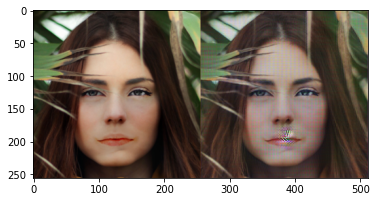

In [18]:
for epoch in range(30):
    gen_model_path = os.path.join(drive_models, 'generator_{}.pkl'.format(epoch))
    print(gen_model_path)
    Gen.load_state_dict(torch.load(gen_model_path))
    with torch.no_grad():
        Gen.eval()
        for n, (x, _) in enumerate(train_loader_src):
            x = x.to(device)
            G_recon = Gen(x)
            result = torch.cat((x[0], G_recon[0]), 2)
            path = os.path.join(args['name'] + '_results', 'Reconstruction', args['name'] + '_train_recon_' + str(n + 1) + '.png')
            # plt.imsave(path, (result.cpu().numpy().transpose(1, 2, 0) + 1) / 2)
            plt.imshow((result.cpu().numpy().transpose(1, 2, 0) + 1) / 2)
            plt.show()
            if n == 4:
                break

        for n, (x, _) in enumerate(test_loader_src):
            x = x.to(device)
            G_recon = Gen(x)
            result = torch.cat((x[0], G_recon[0]), 2)
            path = os.path.join(args['name'] + '_results', 'Reconstruction', args['name'] + '_test_recon_' + str(n + 1) + '.png')
            # plt.imsave(path, (result.cpu().numpy().transpose(1, 2, 0) + 1) / 2)
            plt.imshow((result.cpu().numpy().transpose(1, 2, 0) + 1) / 2)
            plt.show()
            if n == 4:
                break